# **EDA Simplified: DFL Bundesliga Shootout**
![](https://storage.googleapis.com/kaggle-competitions/kaggle/37244/logos/header.png?t=2022-06-30-22-25-12)

## Introduction
Everyone loves soccer. From serving the ball from one side to another side to scoring immense victories against another opponent like the [7-1 humiliation against Brazil in 2014 World Cup](https://en.wikipedia.org/wiki/Brazil_v_Germany_(2014_FIFA_World_Cup)). We've already know the concepts of how the players made teamwork over passing the ball to the other side to score against the other team, and this competition allow us to create a computer model based on the plays made by the players of the DFL Football Team over the Bundesliga Shootout! And that's how we've got our way of EDA into observing the plays of each player from each video with data! So, let's go into it!

## Importing and CSV Setup
For sure, we import the important modules we used in the previous "EDA Simplified" notebook series which is pandas as pd and numpy as np. We also import the famous matplotlib module with the pyplot submodule as plt for visualizing the images and also plotting data out, along with the plotly module with the express submodule as px for also plotting data out. Thus, we also import the os module for operating system stuff on a python notebook.

In [1]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import plotly.express as px

import os

And finally, we import the modules used to analyze the videos from this competition! Before we begin, we need to install the moviepy module from pip. Then, we import the ffmeg_extract_subclip module moviepy module with the video submodule along with the io submodule followed by the ffmpeg_tools module to extract subclips from one of the videos along with Video from the IPython module with the display module for viewing out videos.

In [2]:
!pip install moviepy

from moviepy.video.io.ffmpeg_tools import ffmpeg_extract_subclip
from IPython.display import Video

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 388.3/388.3 kB 7.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... - done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 35.5 MB/s eta 0:00:00
  Created wheel for moviepy: filename=moviepy-1.0.3-py3-none-any.whl size=110743 sha256=e4a9a8b6501327d200de1d56129d2502c2e8a812260d69017bee1205f61a969f
  Stored in directory: /root/.cache/pip/wheels/56/dc/2b/9cd600d483c04af3353d66623056fc03faed76b7518faae4df
Successfully built moviepy
  Attempting uninstall: decorator
    Found existing installation: decorator 5.1.1
    Uninstalling decorator-5.1.1:
      Successfully uninstalled decorator-5.1.1


After installing the moviepy and importing the necessary modules, let's create a single dataframe! We define the train_df variable to the pd module with the read_csv function, containing the file path leading to the train.csv file in the competition data. Finally, we display the train_df dataframe with the head function.

In [3]:
train_df = pd.read_csv("../input/dfl-bundesliga-data-shootout/train.csv")
train_df.head()

,video_id,time,event,event_attributes
0,1606b0e6_0,200.265822,start,NaN
1,1606b0e6_0,201.150000,challenge,['ball_action_forced']
2,1606b0e6_0,202.765822,end,NaN
3,1606b0e6_0,210.124111,start,NaN
4,1606b0e6_0,210.870000,challenge,['opponent_dispossessed']


## Basics Over A Single Dataframe
Now let's go through the basics over one single dataframe, which is the train_df dataframe! First, let's find out how many data entities are there in the train_df dataframe!

In [4]:
len(train_df)

11218

What we saw is that there are 11,218 data entities in the train_df dataframe, meaning that there's a lot of data given for the analysis in each play of the players in the soccer game.

However, we notice that some of the data entities contained NaN values in the train_df dataframe. So in that case, let's find out how many NaN values are there in the train_df dataframe by using the isna function along with the sum function to it.

In [5]:
train_df.isna().sum()

video_id               0
time                   0
event                  0
event_attributes    6836
dtype: int64

As you can see, only the event_attributes has a lot of NaN values with 6836 entities of it, while the data in video_id, time, and event has none of them. That means that some segmented clips of the soccer players haven't made a play action in the videos.

Finally, let's find the shape of the train_df dataframe by using the shape attribute!

In [6]:
train_df.shape

(11218, 4)

After that, we notice that there are 4 rows and 11218 columns of data in the train_df. And aside of the few rows in the train_df dataframe, there are a lot of columns of data for every game played in each video.

## EDA over Events
Now we've done the basics of the train_df dataframe, let's go over the EDA over each event of how the players play in each video!

But before that, let's take a overall look of the players' actions during a soccer match! First, we define a variable, all_events, to the train_df dataframe with the event data index and count it with the value_counts function, setting the normaliziation of our data with the normalize parameter to True.

Next, we define the variable, fig, to the px module with the bar function to create our bar chart, setting the x (x-axis) parameter to the indexes of the all_events variable with the index attribute, the y (y-axis) parameter to the values of the all_events variable with the values attribute times 100, and the color (color label) parameter to the indexes of the all_events variable with the index attribute again. We then label our x and y axes with the update_xaxes and update_yaxes functions to the fig variable figure, setting the title parameter to "Event" (x-axis) and "Number of Them" (y-axis). Furthermore, we update our layout of our figure with the update_layout function figure, setting the showlegend (indicated for showing the legends) parameter to True, title (title for the figure) to "Event Distribution", and template (figure template) set to any built-in template Plotly gave out. Finally, we show our fig variable figure with the show function.

In [7]:
all_events = train_df["event"].value_counts(normalize=True)

fig = px.bar(x=all_events.index, y=all_events.values * 100, color=all_events.index)
fig.update_xaxes(title="Events")
fig.update_yaxes(title="Number of Them")
fig.update_layout(showlegend=True, title="Event Distribution", template="ggplot2")

fig.show()

After running this code cell above, we see that the most distributed events in this bar graph is "play" with about 32 entities, while the least distributed events is "throwin", with 2 entities. However, the counts of "start" and "end" events were alike to each other, both having about 30 entities, meaning that they start and end in a soccer match.

But, after we plot the overall play events in a bar graph, how do we analyze each event one by one? Well, let's find out!

### **Event Chapter 1: throwin**
Since we got into the first chapter event, let's talk about the throw-in event. A throw-in occurs when the game is restarted after the ball went out of the field over the sideline along with the touch of the opposite team. It must be thrown with hands from behind and over the leader of the executing player. [Furthermore, it's governed by Law 15 of "The Laws Of The Game"](https://en.wikipedia.org/wiki/Throw-in).

With all that is being said, let's analyze this event!

In order to analyze only the "throwin" event data, we create a new dataframe, throwin to the train_df dataframe with the train_df dataframe that has the event data index directly equal to "throwin" that resets the index with the reset_index function.

In [8]:
throwin = train_df[train_df["event"] == "throwin"].reset_index()

Now, let's visualize the number of the data in event_attributes in the throwin dataframe! We define the fig variable to the px module with the bar function to create another bar chat, setting the x parameter to the throwin dataframe with the event_attributes data index and count the values of it with the value_counts function along with the index attribute to index it and the y parameter to the throwin dataframe with the event_attributes data index and count the values of it with the value_counts function again but this time finding the values of it with the values attribute. 

We then update our x and y axes on our graph with the update_xaxes and update_yaxes functions to the fig variable figure, setting the title parameter to "event_attributes" (x) and "counts" (y). Finally, we show our fig variable figure with the show function.

In [9]:
fig = px.bar(x=throwin["event_attributes"].value_counts().index, y=throwin["event_attributes"].value_counts().values)
fig.update_xaxes(title="event_attributes")
fig.update_yaxes(title="counts")
fig.show()

Once we created this graph above, we see that ["pass"] has the most value counts in the throwin dataframe with 154 entities of it, while ["cross"] has the least value counts in the throwin dataframe with just 18 entities of it.

And since the most values is ["pass"], let's go on into visualizing one example of it!

But before that, we need to define a function to visualize an event in the video, called visualize_event, setting the row variable inside, along with the before (before event) parameter to 5 and after (after event) parameter to 5. 

Whilst inside the visualize_event function, we print out the row variable input with the event_attributes data index first, then define the filepath variable to the formatted string of "test_{}.mp4", setting the row variable with the index data index inside of that. We then extract some subclips of the specific video input with the ffmpeg_extract_subclip function, extracting the formatted string of the file path leading to the video file in .mp4 format which contains the row variable with the video_id data index and then setting the integer conversion with the int function in the row variable with the time data index subtracted by the before value along with adding the after variable separately thus setting the targetname (the name of the target) parameter to the filepath variable. Finally, we return the Video function to display out the video of the filepath variable input thus setting the width (width of the video) to 800.

In [10]:
def visualize_event(row, before=5, after=5):
    print(row["event_attributes"])
    filepath = f"test_{row['index']}.mp4"
    ffmpeg_extract_subclip(
        f"../input/dfl-bundesliga-data-shootout/train/{row['video_id']}.mp4",
        int(row["time"]) - before,
        int(row["time"]) + after,
        targetname = filepath
    )
    
    return Video(filepath, width=800)

With the visualize_event function being set, up let's bolt onwards to visualizing the ["pass"] event!

#### **["pass"]**
When we go on to this section, we need to know about it before we visualize the data there. A "pass" event occurs when it is defined to any attempt to switch ball control to another member of the team that didn't satisfy "cross" event definition, which we'll explain it to the next section. So in that case, to visualize it, we use the visualize_event function we created, setting the input to throwin dataframe with indexing on integer location with the iloc attribute that has the slice index of 1.

In [11]:
visualize_event(throwin.iloc[4])

['pass']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


If you skip the timestamp of this video above to 0:05, you'll see that the player performed the ["pass"] event since they "throwin" the ball outside in one of the crossing player zones around the field. Speaking of cross zones in soccer, let's move on to visualizing the ["cross"] events.

#### **["cross"]**
So what is a cross event in a soccer match? A cross event happens when a player kick or throw the ball inside to one of the four corners of the soccer field. These four zones around each corner of the soccer field were marked by the touchlines, along with the extended sides of the penalty area and the goal lines thus the imaginary quarter-way lines, in which would be drawn at the quarter of the length of the pitch parallel to the halfway line. Also, there is a cross recipent zone, in which it must be located roughly in the penalty area thus between in two crossing player zones. To play this event, a player must perform a throw-in play in medium-length, notably 10 to 30 meters or more than that.

With all of that explained, we visualize a ["cross"] event by using the visualize_event function to the throwin dataframe with the index location known is the iloc attribute with the slice index of 11.

In [12]:
visualize_event(throwin.iloc[11])

['cross']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


Again, once we get to the timestamp of the video output after 5 seconds, we see that the other player of the DFL soccer match played a throw-in in one of the crossing player zones, in which a cross event occurs.

In conclusion, we've finished analyzing the "throwin" event! Without a doubt, let's hit the "play" button on the next event of a soccer match!

### **Event Chapter 2: play**
Before we begin, let's go over the facts about the play event! A play event happens when a player's attempt to switch ball control to the other player, which it may be executed as a pass or a cross.

So, let's create another dataframe based out of the play event! We define the play variable to the train_df dataframe with the data index of the train_df dataframe's event data that is directly equal to play and reset their index with the reset_index function.

In [13]:
play = train_df[train_df["event"] == "play"].reset_index()

Now, let's visualize the overall data in the play dataframe in a pie chart! We define the fig figure variable to the px module with the pie function, setting the play dataframe as our dataframe input, the values (values for the pie chart) parameter to the play dataframe that has the event_attributes data index with the value_counts function to count the values of it along displaying the values with the values attribute, the names (names to label the pie chart) attribute to the play dataframe's event_attributes data index with the value_counts function to count the values of it again but indexing the labels of it with the index attribute, and setting the title to "Percentage of the Data in the Play Event". Finally, we show our fig variable figure with the show function.

In [14]:
fig = px.pie(play, values=play["event_attributes"].value_counts().values, names=play["event_attributes"].value_counts().index, title="Percentage of the Data in the Play Event")
fig.show()

Once we finished creating our pie chart, we analyzed that 93.1% of the event_attributes data in the play dataframe is ['pass', 'openplay'] while 3.54% and 2.23% of it is ['pass', 'freekick'] and ['cross', 'openplay']. Thus, there's a small number of data in the play dataframe, which is ['cross', 'corner'], ['cross', 'freekick'], and ['pass', 'corner'] each having 0.92%, 0.14%, and 0.11% of it. In other words, the play event's execution as a Pass has more data than the play event's execution as a Cross.

#### **["pass", "openplay"], ["cross", "openplay"]**
And with that, let's go over the openplay event subpart first! Basically, an open play is when the competing teams are passing the ball, running, and trying to score a goal without a dead ball situation (when a soccer match is completely stopped).

Without a doubt, we use the visualize_event function again to the play dataframe with the index location (iloc) attribute with a slice index of 1, setting the before parameter to 2 and the after parameter to 10.

In [15]:
visualize_event(play.iloc[1], before=2, after=10)

['pass', 'openplay']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


Per the whole duration of the video above, we see that the two teams were passing the ball from back and forth, without any dead ball situations.

And now let's analyze the cross openplays! It's like the same as what we did for analyzing the openplays in the pass event, but this time, we set the play dataframe's index location (which is the iloc attribute) to 16, along with the after parameter to 4.

In [16]:
visualize_event(play.iloc[15], before=2, after=4)

['cross', 'openplay']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


Unlike the previous video (see above from this video), this video showed that three players passed the ball in a medium to long range. Apparently, that's one example of how a cross event can happen in an open play event.

#### **["pass", "freekick"], ["cross", "freekick"]**
In some sports, a free play happens when there's a foul during the match of a sport. And since this is soccer, a free play in this refers to a free kick. Basically, it's a situation in which the Play is protocoled to restart the whole game after the referee stopped it because of an infringement of the rules or a foul. Thus, the ball must be stationary on the ground when a free play starts.

Without a doubt, we are going to use the visualize_event function to visualize the play dataframe again but with the index location of 70, thus setting the before parameter to 2 and the after parameter to 2.

In [17]:
visualize_event(play.iloc[70], before=2, after=2)

['pass', 'freekick']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


Before the video instantly skips to the very end, we saw that one of the players performed a free kick whilst keeping the ball stationary on the ground. But what about the cross event over this?

Well, to analyze the cross event version of the free kick event, we use the visualize_event again, setting the play dataframe's index location with the iloc attribute containing the slice index of 1494, thus setting the before parameter to 2 along with the after parameter, which we set it to 6.

In [18]:
visualize_event(play.iloc[1494], before=2, after=6)

['cross', 'freekick']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


What you see from this video is that the player performed a free kick to the right of the soccer field, making it a cross event since it kicked a ball from somewhat a long range. Thus, the ball bounced out of the field after performing a cross freekick.

#### **["pass", "corner"], ["cross", "corner"]**
Now that we've covered up the freekick event of a soccer match, let's explain and visualize what is a corner kick! Basically, a corner kick is refered to an event in which the Play is executed to start over a match after the ball went out of the goal line (like the above video in the previous section) along with the touch of the defending team player. It also must be stationary on the ground just like a freekick event, but it must be kicked off from the nearest corner of the soccer field.

Without a doubt, let's use the visualize_event function for this event, setting the play dataframe as our input, but setting the index location with the iloc attribute to 2092, along setting the before and after parameters to 2.

In [19]:
visualize_event(play.iloc[2092], before=2, after=2)

['pass', 'corner']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


Per visualizing the corner pass video strip, we see that a player kicked the ball from the lower-right corner of the soccer field. This may represent that the ball in the previous match was kicked out of bounds by a player.

Now let's visualize the cross event! We use the visualize_event function again and then put the play dataframe with the index location, which is iloc, of 181, and then setting the before and after parameters to 2.

In [20]:
visualize_event(play.iloc[181], before=2, after=2)

['cross', 'corner']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


In the cross version of the corner play event, we can see that a player performed a long range kick from the lower left corner of the soccer field. Furthermore, we can see a goalkeeper about to reach the flying ball from a player who performed a corner cross kick along with the players, in which they were rushing to the flying ball too.

With all of the data covered over the play event, let's warp into the final event chapter of the game!

### **Event Chapter 3: Challenge**
So what is a challenge? A challenge is an action players use in which the two teams that is opposed to each other are physically capable of claiming the ball control so that they can score a goal to the opposing side. However, this event required one of the two opposing players to touch the ball or foul the opposing player. 

With all of that being said, let's create a dataframe, challenge, to reset the indexes of the train_df dataframe with the train_df dataframe's event data index that is directly equal to the challenge input.

In [21]:
challenge = train_df[train_df["event"] == "challenge"].reset_index()

After that, let's plot out the overall data in this newly created challenge dataframe! For the last time in this last chapter event, we define a pie chart in Plotly again, but this time, setting the challenge dataframe as our dataframe input of the pie function, along setting the title parameter to "Challenge Event Distribution by Percentage".

In [22]:
fig = px.pie(challenge, values=challenge["event_attributes"].value_counts().values, names=challenge["event_attributes"].value_counts().index, title="Challenge Event Distribution by Percentage")
fig.show()

Once we created this graph above, 38.3% of the data is "ball_action_forced", which is the most while 22.1% of it is "opponent_dispossed", 17.8% of it is "challenge_during_ball_transfer", 8.49% of it is "possession_retained", and finally, 6.25% of the data is "opponent_rounded, which is the least.

With all of the event_attributes explained overall, let's go through to each of them one by one!

#### **["ball_action_forced"]**
Basically, a "ball_action_forced" happens when the ball action carried out in any events of the soccer game. Basically, it applies when none of any players involved in the challenge over the ball control at the start of it while other player determines the direction of the ball at the end of the challenge.

So, to start visualizing the event, we use the visualize_event function, setting the index location of the challenge dataframe to 4 with the iloc attribute, along with the before and after attributes to 4.

In [23]:
visualize_event(challenge.iloc[4], before=4, after=4)

['ball_action_forced']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


What we saw from the fourth video slice index of the challenge dataframe, a player from the right side from the soccer field starts to kick the ball, triggering the start of the soccer match.

#### **["opponent_dispossessed"]**
In terms of a soccer event, an "opponent_dispossessed" event occurs when a player that isn't in ball control steals the ball from the opposing player in ball control. Speaking of which, it can happen anytime during the soccer game.

To visualize the "opponent_dispossessed" event, we simply call out the visualize_event function, setting the challenge dataframe with the index location, iloc to the slice index of 3, along setting the before and after attributes to the value of 4.

In [24]:
visualize_event(challenge.iloc[3], before=4, after=4)

['opponent_dispossessed']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


As you can see, there are two instances in which the players from both sides dispossess their ball control at each other. The first of that event is that the white uniform player dispossesses the ball control of the red uniform player, and other the red uniform player dispossesses the ball control of the white uniform player, tripping the white uniform player.

#### **["fouled"]**
During a soccer match, some players from both sides sometimes play rough on each other, trying to claim the ball to reach the goal from the other side. However, some rough plays from them may potentially cause a foul from a referee. In other words, a "fouled" event happened when a referee called a foul. And speaking of this event, a foul can sometimes include a referee calling out a yellow card for warning or worse, a red card to expel out a misconducting player from any side of a soccer match.

So, let's use the visualize_event again, using the index location of the iloc attribute to 14 from the challenge dataframe, and setting the before and after attributes to 4.

In [25]:
visualize_event(challenge.iloc[14], before=4, after=4)

['fouled']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


Whoa, what a rough play the two players made! The referee called out a foul after a player tripped on another player, pinning him to the ground. Fortunately, it is not a serious foul, as the referee didn't pull out the yellow or red card.

#### **["challenge_during_ball_transfer"]**
Basically, this event occurs when a challenge occurs during the release of the ball. It applies when the shots of a ball played are forced or blocked during a challenge, which is only recorded if the ball played or shot travels through the area that the defensive player is attemptigng to cover it from a tactical perspective. However, all of the other cases aren't recorded as challenges.

To get started, we use the visualize_event function, setting the index location of 52 from the challenge dataframe with the iloc attribute, along setting the before and after attributes to 4.

In [26]:
visualize_event(challenge.iloc[52], before=4, after=4)

['challenge_during_ball_transfer']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


What we saw from this video output, we see that the players from both sides blocked the ball transfer at each other, then crash each other for the three players involved and then the player with the white uniform kicked the ball very far.

#### **["possession_retained"]** 
In most soccer events, a "possession_retained" event can occur when one of any players from both sides involved in the challenge that has ball control at the beginning of the challenge and manages to reclaim the possession the ball control amid the efforts to dispossess him or the opponent involved during the challenge.

So with all of that being said, let's use the visualize_event function to visualize this event, inputting the challenge dataframe with the iloc attribute for index location, setting it to 24 along with the before and after attributes to 4 again.

In [27]:
visualize_event(challenge.iloc[24], before=4, after=4)

['possession_retained']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


For this sliced index of this video, we see that the player with the white uniform's ball control has been taken by the player with the red uniform and then kick the ball to a white-uniform player and block it from reaching the goal, retaining the ball possession.

#### **["opponent_rounded"]**
Now here's the last event of the soccer match we're going to analyze with, the "opponent_rounded" event. This event can happen when any player in ball control holds in their ball control after the challenge, leaving the opposing player behind them. The situation in which the opponent is unable to gain ball control are also be recorded as a challenge.

With our final analysis of this event, we call out the visualize_event one last time, setting the index location of 12 with the iloc attribute to the challenge dataframe, along setting up the before and after attributes to 4.

In [28]:
visualize_event(challenge.iloc[12], before=4, after=4)

['opponent_rounded']
Moviepy - Running:
>>> "+ " ".join(cmd)
Moviepy - Command successful


After we made our final video analysis over this event, we observed that the red-uniform player kept in ball control from the white-uniform player, tripping him in the process.

And we are finally done with visualizing all of the events mentioned in this "EDA Event" section! Now with all of that covered up, let's go to process the videos in this Bundesliga competition data!

## Video Processing & Slicing
After visualizing over the events, let's get over the video processing and slicing over the frames! 

Before we begin doing that, we import the cv2 module provided by OpenCV first. Next, we define the vidcap variable to capture the video footage data with the VideoCapture function by the cv2 module, leading to any test video data, like test_79.mp4. And finally, once the vidcap variable has capture the video footage, the success and image variables is defined to reading out the vidcap variable with the read function.

In [29]:
import cv2
vidcap = cv2.VideoCapture("test_79.mp4")
success, image = vidcap.read()

Now after this setup, let's generate an image based out of a video! We redefine the image variable to convert the image to the rgb color from bgr color with the cvtColor function from the cv2 module, putting the previous image variable inside with the COLOR_BGR2RGB attribute from the cv2 module. Next, we setup our Matplotlib figure with the figure function from the plt module, setting the figsize parameter to 16 by 8, in slices. Finally, we show the image of the image variable with the imshow function that is provided by the plt module.

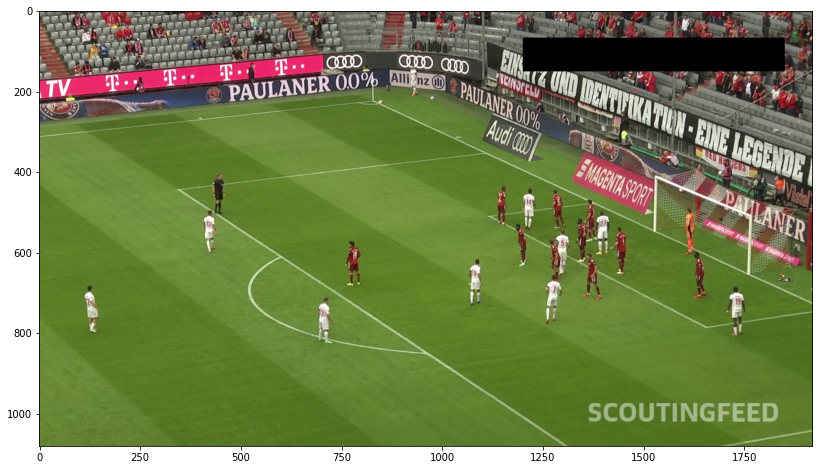

In [30]:
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(16,8))
plt.imshow(image)

For this image from the segment of a soccer video, we see that the referee called a foul since the players from both teams were gathered together. 

Time to find how many fps, frame counts, and frames are there in a test video! we define the fps variable to the vidcap variable and obtain it with the get function, setting the cv2 module with the CAP_PROP_FPS attribute of the frame rate. Next, we print the fps of this test video with the fps variable inside. Now, let's get the frame count of that video again by defining the frame_count variable to the vidcap variable with the get function to obtain the frame count from the CAP_PROP_FRAME_COUNT attribute from the cv2 module and print it.

And here's the final part, counting all of the frames from a test video. We set the count counter variable to 0 first, then create a while loop, looping success setting to True. While doing that, the count counter's increment is increased by 1, and success and image variables is redefined to read the video from the vidcap varible. Once the success variable looping is done, we finally print the number of frames with the count variable.

In [31]:
fps = vidcap.get(cv2.CAP_PROP_FPS)
print(f"fps: {fps}")

frame_count = vidcap.get(cv2.CAP_PROP_FRAME_COUNT)
print(f"frame_count: {frame_count}")

count = 0
while success:
    count += 1
    success, image = vidcap.read()
    
print(f"Overall frames: {count}")

fps: 25.0
frame_count: 227.0
Overall frames: 201


What we saw from the stats from the test video after this was printed out, the fps of it is 25, the frame count is 227, and the frames overall is 201.

Now, let's create a figure based out of every frame-at-a-time! First, we configure our Matplotlib figure with the figure function from the plt module, setting the figsize parameter to 16 by 48 and then redefine the vidcap variable to what we did previously to analyzing a single frame. Next, we create the np_video variable to an empty list, and step variable to 18. We then define a while loop just like how we did for finding out the overall frames previously. Inside of that, the image variable is defined to what we did previously for displaying the standalone frame from a test video and then append the image variable into the np_video list with the append function. The if statement has been defined, whether if it is not the modulus division of count and step, then the subplot will generate from the subplot function from the plt module, setting it 6 by 2, indexing it by the count variable divided by the step value variable and then added by 1. Furthermore, the image variable is shown by the imshow function from plt then the axis is turned off by the plt module with the axis function. And outside of the if statement, the success and image variables is redefined to reading the vidcap video variable, along incrementing the count counter by 1.

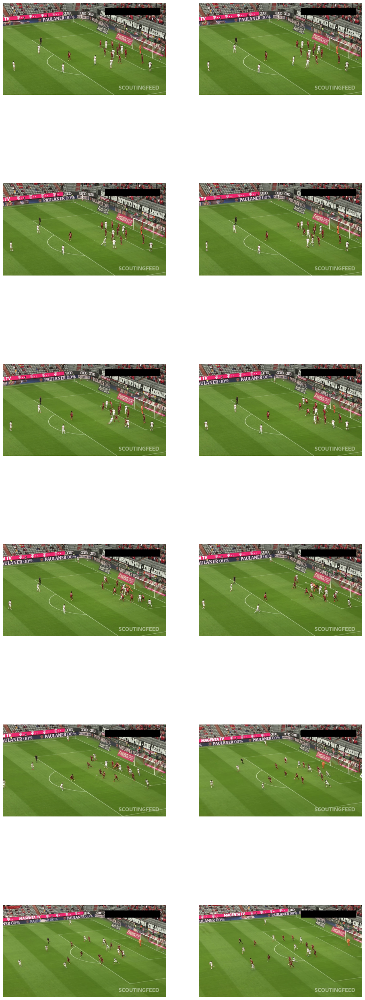

In [32]:
plt.figure(figsize=(16, 48))

vidcap = cv2.VideoCapture("test_79.mp4")
np_video = []

success, image = vidcap.read()
count = 0
step = 18
while success:
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    np_video.append(image)
    if not count % step:
        plt.subplot(6, 2, count // step + 1)
        plt.imshow(image)
        plt.axis("off")
    success, image = vidcap.read()
        
    count += 1

From every frame at a time, we noticed of how players from both teams passed the ball from one player to another, while seeing how the game starts when the players from both teams gathered around the referee.

Time to start creating a video in the "Matplotlib" style! First, we import the animation and rc modules from the matplotlib module and configure the rc module by calling the rc function and setting it to animation along with the html option parameter to jshtml. Next, we defined a function called create_animation, setting the ims variable as the function's parameter. 

Inside the create_animation function, the fig variable is defined to the figure setup by the plt module with the figure function, configuring the figsize parameter to 6 by 6, along setting the axis option to off with the axis function from plt module. After that, the im variable is defined to the showing the images with the imshow function that is provided by the plt module, setting the first slice of the ims function parameter, along setting the cmap parameter to gray for the color map. Later on, a new function is defined inside the create_animation function, which is the animate_func function, containing the i variable parameter for this function. From the animate_func function, the im variable is commanded to set up an array with the set_array function, inputting the ims variable with the slice index of i to iterate every slice of a video and returning the im variable inside the square brackets. And finally, on the outside of the animate_func function, we return the created video from every slice with the animation module with the FuncAnimation function to create an animation video, setting the fig variable and the animate_func function, and configuring the frames parameter to the number of entities with the ims variable by the len function and the interval parameter to 1000 divded by 24.

In [33]:
from matplotlib import animation, rc
rc('animation', html='jshtml')

def create_animation(ims):
    fig = plt.figure(figsize=(6,6))
    plt.axis("off")
    im = plt.imshow(ims[0], cmap="gray")
    
    def animate_func(i):
        im.set_array(ims[i])
        return [im]
    
    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//24)

Now let's create our animation video with the create_animation function, setting the np_video as our input!

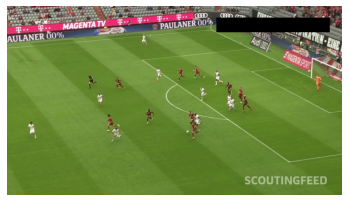

In [34]:
create_animation(np_video)

From this first segment of the "test_79.mp4" video footage, we analyzed that the players from both teams gather together for one of the player to start the game after a referee called a foul from the previous match. Furthermore, an image is displayed, showing that the players from both teams were passing the ball from one player to another.

Finally, for our video processing, let's change the video frame's colors! we define the variable, fragment_from_test_video to the np_video variable with the slice index of 0 to indicate that it is the first slice of the video frame. Then we setup the figure and show the image video frame just like how we did previously for a standard image, but however, for the second image displays, we define the gray_image variable modifier to the cv2 module with the cvtColor function to change the fragment_from_test_video variable's colors to gray by using the cv2 module with the COLOR_FROM_RGB2GRAY attribute and then use the imshow function from the plt module, setting the gray_image as our image input and setting the cmap parameter to gray. And for the third one, we show the gray_image variable just like the second one, but the gray_image variable's color saturation is set greater than or equal to 182.

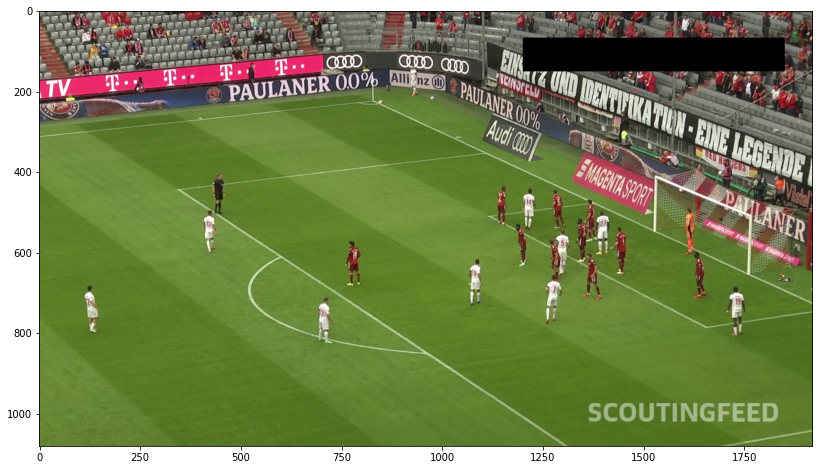

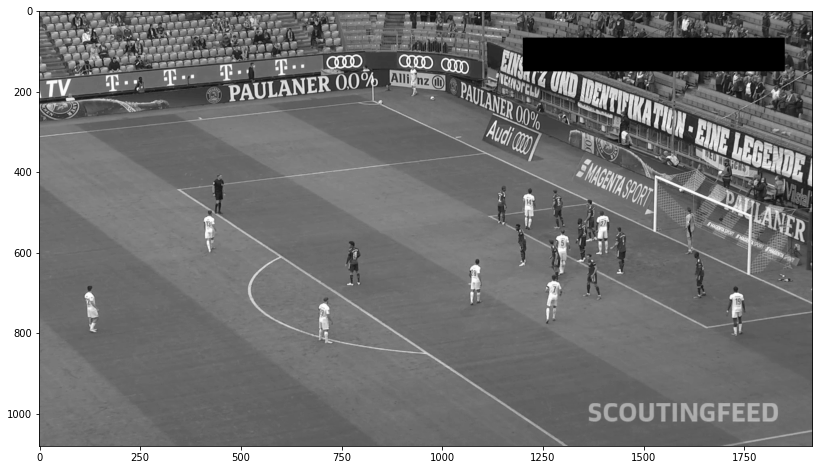

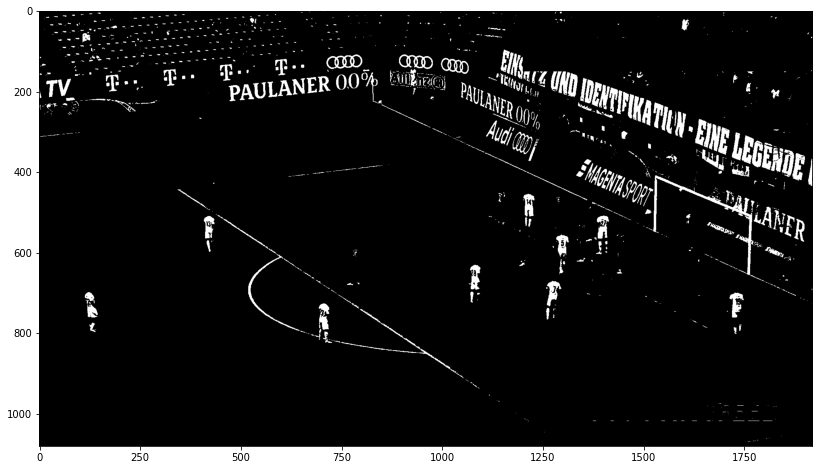

In [35]:
fragment_from_test_video = np_video[0]

plt.figure(figsize=(16,8))
plt.imshow(fragment_from_test_video)

plt.figure(figsize=(16,8))
gray_image = cv2.cvtColor(fragment_from_test_video, cv2.COLOR_RGB2GRAY)
plt.imshow(gray_image, cmap="gray")

plt.figure(figsize=(16,8))
plt.imshow(gray_image >= 182, cmap="gray")

What we see from this first frame of "test79.mp4", we see that their color is inverted to gray for the second one and then to black for the third one unlike the first one.

Now's it's the time of our finale of our section over video preprocessing and slicing! Based on [Towards Data Science](https://towardsdatascience.com/football-players-tracking-identifying-players-team-based-on-their-jersey-colors-using-opencv-7eed1b8a1095), we define the color_list variable to "red", "blue", and "white" in a list, then set up the boundaries to a list that contains the three slice indexes of two tuples: (17, 15, 75) and (50, 56, 200) for red, (43, 31, 4) and (250, 88, 50) for blue, (187, 169, 112) and (255, 255, 255) for white.

In [36]:
color_list = ['red', 'blue', 'white']

boundaries = [
    ((17,15,75), (50,56,200)), # indicates red
    ((43,31,4), (250,88,50)), # indicates blue
    ((187,169,112), (255,255,255)) # indicates white
]

Time to plot every frame at a time with the player tracking mode! we defined a for loop, looping color and boundary variables in aggrevating the color_list and boundaries list variables into a tuple with a zip function. 

Inside the for loop, the mask variable is defined to the cv2 module with the inRange function to make the fragment_from_test_video video frame variable in frame, with the boundary loop variable that has the slice index of 0 and 1, alongside with the output variable being assigned to bitwise_and function of the cv2 module, returning the array of the fragment_from_test_video slice video frame variable twice thus setting the mask parameter to the mask variable. 

And time for plotting (inside the for loop)! We first configure the figure of our plotting figure with the figure function from the plt module, setting the figsize parameter to 16 by 12. Then, in each same slice of the video frame image, we define the subplot to 2, 2, and 1 with the subplot function from plt, along showing the fragment_from_test_video image slice frame with the imshow function provided by the plt module, to indicate the original form with no modifications and then the setting the subplot to 2, 2, and 3 and show the output image variable with the imshow function of the plt module, and finally setup another subplot of 2, 2, and 2 with the plt module's subplot function again and showing the image of the mask image variable with the imshow function of the plt module and showing all of them with the show function from the plt module.

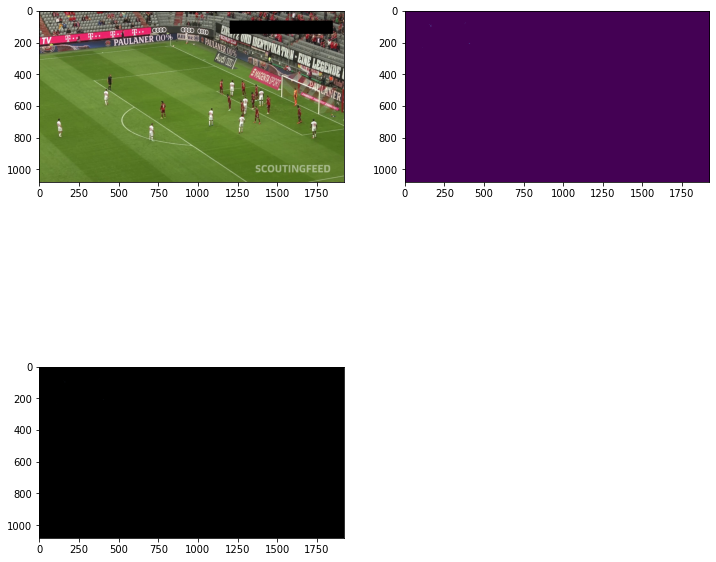

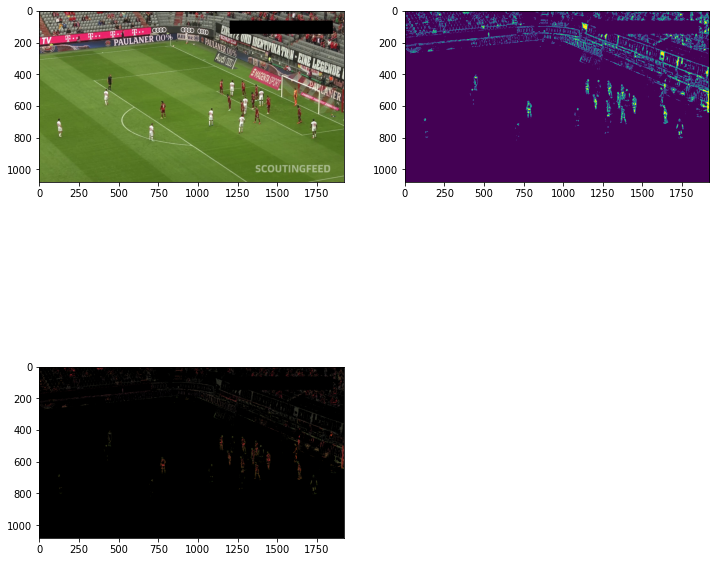

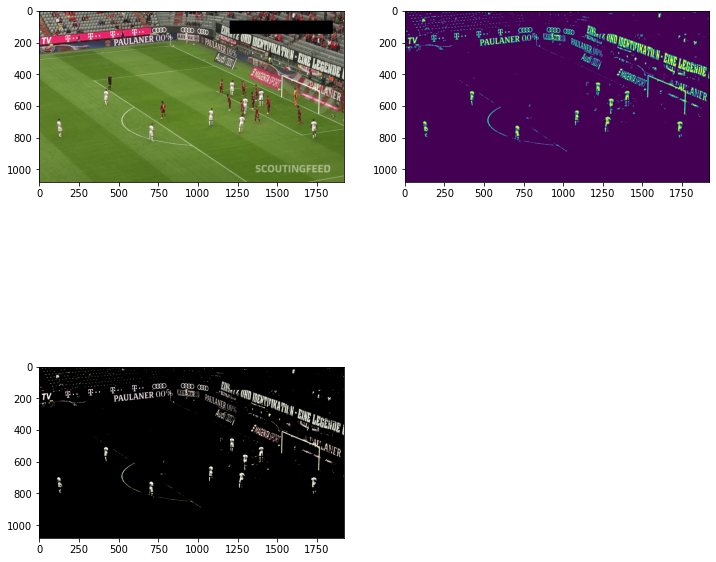

In [37]:
for color, boundary in zip(color_list, boundaries):
    mask = cv2.inRange(fragment_from_test_video, boundary[0], boundary[1])
    output = cv2.bitwise_and(fragment_from_test_video, fragment_from_test_video, mask=mask)
    
    plt.figure(figsize=(12,12))
    plt.subplot(2,2,1)
    plt.imshow(fragment_from_test_video)
    
    plt.subplot(2,2,3)
    plt.imshow(output)
    
    plt.subplot(2,2,2)
    plt.imshow(mask)
    
    plt.show()

For every three batches of image plotted three times, we observed that there are no blue uniform players around this test video slice, but there are red and white uniform players masked.

And with all of that covered up, we're done with all of the EDA and Video Slicing, Preprocessing over this notebook!

## Conclusion
For all the data in the Bundesliga covered up with our analysis, we played an overwhelmingly good data exploration on each players' move on passing and crossing the ball control from one to another and challenge each other from each match! With all the soccer analysis being done, we can move onto our video EDA over american football, hockey, basketball, or [quidditch](https://en.wikipedia.org/wiki/Quidditch_(real-life_sport)).